# INTERACTION

## About

The INTERACTION dataset (INTERnational, Adversarial and Cooperative moTION) was created and published by the Mechanical Systems Control (MSC) Laboratory, Department of Mechanical Engineering, University of California, Berkeley. The dataset targets at promoting research in many different domains of mobility. The dataset can therefore be downloaded and used free of charge for academic and research purposes.

The dataset contains a variety of highly interactive driving scenarios from different countries, such as roundabouts, signalized/unsignalized intersections, as well as highway/urban merging and lane change. The driving behavior in the dataset are highly impacted by other drivers, whose behavior can be aggressive or irrational due to the social pressure. Near-collision or slight-collision scenes are contained in the dataset to facilitate the research for critical situations. The dataset consists of 16.5 hours of 40k+ trajectories of vehicles, cyclists, and pedestrians from 11 locations of different types.

### How to Apply Dataset

The INTERACTION dataset is free for non-commercial use only. According to the license and protocols, as a third-party, we cannot share any form of this dataset online. Please visit [the official website](https://interaction-dataset.com/) of INTERACTION, fill in the application form and send your request.

### Citation

```latex
@article{zhan2019interaction,
  title={Interaction dataset: An international, adversarial and cooperative motion dataset in interactive driving scenarios with semantic maps},
  author={Zhan, Wei and Sun, Liting and Wang, Di and Shi, Haojie and Clausse, Aubrey and Naumann, Maximilian and Kummerle, Julius and Konigshof, Hendrik and Stiller, Christoph and de La Fortelle, Arnaud and others},
  journal={arXiv preprint arXiv:1910.03088},
  year={2019}
}
```

## Data Analysis

> This part is independently conducted by Tactics2D.

In [1]:
%matplotlib inline
import warnings

warnings.filterwarnings("ignore")

import logging

logging.basicConfig(level=logging.WARNING)

import os
import pandas as pd
import polars as pl
import numpy as np
import matplotlib as mpl
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# Setting up parameters for matplotlib
mpl.rcParams.update(
    {
        "figure.dpi": 100,
        "font.family": "DejaVu Sans Mono",
        "font.size": 6,
        "font.stretch": "semi-expanded",
        "animation.html": "jshtml",
        "animation.embed_limit": 5000,
        "axes.edgecolor": "black",
        "axes.linewidth": 0.8,
        "axes.grid": True,
        "grid.color": "#cccccc",
        "axes.facecolor": "white",
    }
)
sns.set_palette("Set2")

In [3]:
locations = [
    "DR_DEU_Merging_MT",
    "DR_CHN_Merging_ZS",
    "DR_USA_Roundabout_SR",
    "DR_CHN_Roundabout_LN",
    "DR_DEU_Roundabout_OF",
    "DR_USA_Roundabout_FT",
    "DR_USA_Roundabout_EP",
    "DR_USA_Intersection_EP0",
    "DR_USA_Intersection_EP1",
    "DR_USA_Intersection_MA",
    "DR_USA_Intersection_GL",
    "TC_BGR_Intersection_VA",
]
data_path = "../../data/INTERACTION/recorded_trackfiles/"

### Distribution of Trajectory on Map

![Trajectories on maps](../assets/interaction.png)

### Distribution of Trajectory Categories

The distribution of trajectory categories exhibits substantial variation across different locations. At a single location, the proportion of vehicle trajectories also fluctuates over time or between samples.

In [4]:
dfs = []
df_meta = []
for location in locations:
    location_path = os.path.join(data_path, location)
    files = os.listdir(location_path)
    df_all = pl.DataFrame()
    for file_name in files:
        if file_name.startswith("vehicle_tracks_") and file_name.endswith(".csv"):
            file_id = int(file_name.split(".")[0].split("_")[-1])
            df_vehicle = pl.read_csv(os.path.join(location_path, file_name), ignore_errors=True)
            df_vehicle = df_vehicle.select(
                ["track_id", "frame_id", "agent_type", "x", "y", "vx", "vy"]
            )
            df_vehicle = df_vehicle.with_columns(
                pl.lit(file_id).alias("fileId"),
                pl.col("track_id").cast(pl.String),
                pl.col("frame_id").cast(pl.Int64),
                pl.col("agent_type").cast(pl.String),
                pl.col("x").cast(pl.Float64),
                pl.col("y").cast(pl.Float64),
                pl.col("vx").cast(pl.Float64),
                pl.col("vy").cast(pl.Float64),
            )

            ped_file = os.path.join(location_path, f"pedestrian_tracks_{file_id:03d}.csv")
            if os.path.exists(ped_file):
                df_pedestrian = pl.read_csv(ped_file)
                df_pedestrian = df_pedestrian.select(
                    ["track_id", "frame_id", "agent_type", "x", "y", "vx", "vy"]
                )
                df_pedestrian = df_pedestrian.with_columns(
                    pl.lit(file_id).alias("fileId"),
                    pl.col("track_id").cast(pl.String),
                    pl.col("frame_id").cast(pl.Int64),
                    pl.col("agent_type").cast(pl.String),
                    pl.col("x").cast(pl.Float64),
                    pl.col("y").cast(pl.Float64),
                    pl.col("vx").cast(pl.Float64),
                    pl.col("vy").cast(pl.Float64),
                )
                df_all = pl.concat([df_all, df_vehicle, df_pedestrian])
                denom = len(df_vehicle) + len(df_pedestrian)
                ratio = len(df_vehicle) / denom if denom > 0 else 0
                df_meta.append([location, file_id, ratio])
            else:
                df_all = pl.concat([df_all, df_vehicle])
                ratio = 1 if len(df_vehicle) > 0 else 0
                df_meta.append([location, file_id, ratio])
    dfs.append(df_all)

df_meta = pd.DataFrame(df_meta, columns=["location", "file_id", "ratio"])

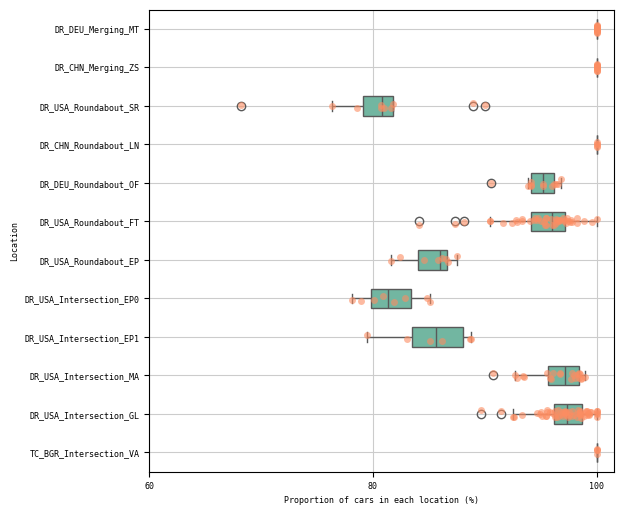

In [5]:
f, ax = plt.subplots(figsize=(6, 6))

sns.boxplot(data=df_meta, x="ratio", y="location", width=0.5, ax=ax)

sns.stripplot(data=df_meta, x="ratio", y="location", alpha=0.6, ax=ax)

ax.set_xticks([0.6, 0.8, 1.0])
ax.set_xticklabels(["60", "80", "100"])
ax.yaxis.grid(True)
ax.set_xlabel("Proportion of cars in each location (%)")
ax.set_ylabel("Location")
plt.show()

### Distribution of Average Speed on Map



In [6]:
for i in range(len(locations)):
    x_min = np.floor(dfs[i]["x"].min())
    x_max = np.ceil(dfs[i]["x"].max())
    y_min = np.floor((-dfs[i]["y"]).min())
    y_max = np.ceil((-dfs[i]["y"]).max())
    vx = dfs[i]["vx"].to_numpy()
    vy = dfs[i]["vy"].to_numpy()

    x_edges = np.linspace(x_min, x_max, num=int((x_max - x_min) * 10 + 1), endpoint=True)
    y_edges = np.linspace(y_min, y_max, num=int((y_max - y_min) * 10 + 1), endpoint=True)
    x_bin = np.digitize(dfs[i]["x"].to_numpy(), x_edges) - 1
    y_bin = np.digitize((-dfs[i]["y"]).to_numpy(), y_edges) - 1
    speed = np.sqrt(vx**2 + vy**2)

    dfs[i] = dfs[i].with_columns(
        [pl.Series("x_bin", x_bin), pl.Series("y_bin", y_bin), pl.Series("speed (m/s)", speed)]
    )

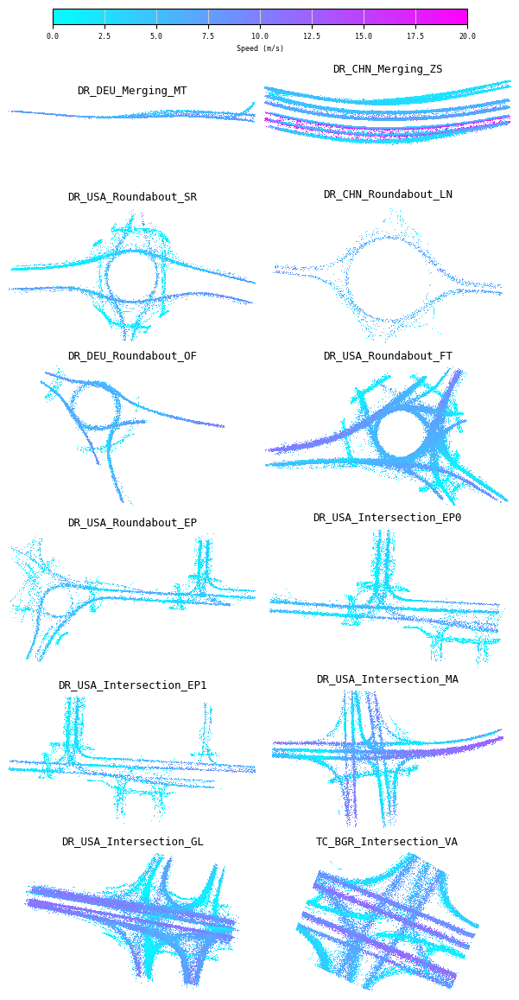

In [7]:
fig, axes = plt.subplots(int(np.ceil(len(locations) // 2)), 2, figsize=(6, 12))
axes = axes.flatten()

for i, (df, location) in enumerate(zip(dfs, locations)):
    ax = axes[i]

    df_speed_heatmap = (
        df.group_by(["y_bin", "x_bin"])
        .agg(pl.col("speed (m/s)").mean().alias("avg_speed"))
        .sort(["y_bin", "x_bin"])
    ).to_pandas()

    grid = df_speed_heatmap.pivot(index="y_bin", columns="x_bin", values="avg_speed")

    sns.heatmap(
        grid, ax=ax, cmap="cool", cbar=False, xticklabels=False, yticklabels=False, vmin=0, vmax=20
    )
    ax.set_aspect("equal")
    ax.set_title(location, fontsize=9)
    ax.set_xlabel("")
    ax.set_ylabel("")

for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

cbar_ax = fig.add_axes([0.1, 0.94, 0.8, 0.015])
fig.colorbar(axes[0].collections[0], cax=cbar_ax, orientation="horizontal", label="Speed (m/s)")

fig.tight_layout(rect=[0, 0, 1, 0.93])
plt.show()

### Distribution of Speed by Location

By comparing the speed distribution of different locations, we can observe that in INTERACTION, the speed pattern is closely related to the type of location. For example, the roundabouts shares a peak at about 6 m/s, while the intersections has more values concentrated around 0 m/s, indicating that vehicles are more likely to stop at intersections. The merging and lane change locations have a wider distribution of speed, with a peak around 10 m/s, which is the typical speed of vehicles on highways.

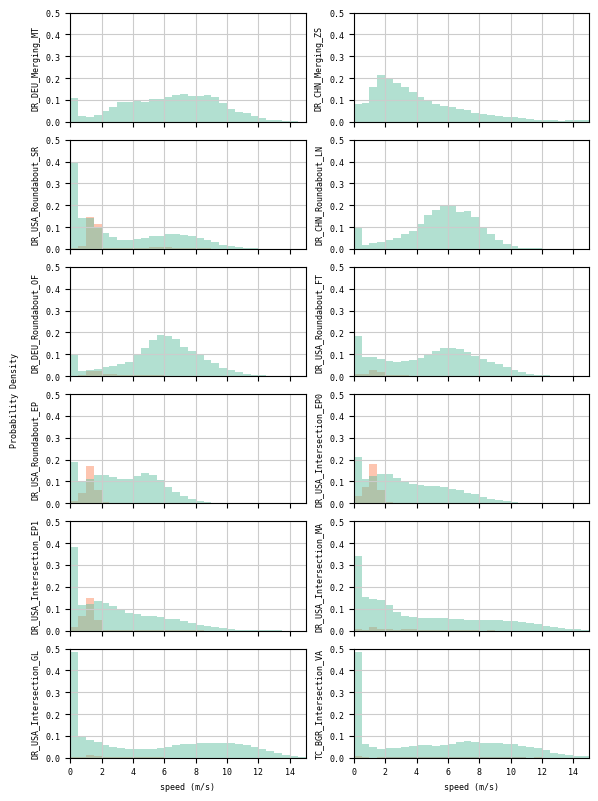

In [8]:
fig, axes = plt.subplots(
    int(np.ceil(len(locations) // 2)), 2, figsize=(6, 8), sharex=True, sharey=False
)

for i, location in enumerate(locations):
    df_speed = dfs[i].to_pandas()
    df_speed = df_speed.dropna(subset=["speed (m/s)", "agent_type"])

    sns.histplot(
        df_speed,
        x="speed (m/s)",
        hue="agent_type",
        palette="Set2",
        ax=axes[i // 2][i % 2],
        stat="density",
        binwidth=0.5,
        binrange=(0, 15),
        linewidth=0,
        alpha=0.5,
        legend=False,
    )

    if i == 2:
        legend_handles, legend_labels = ax.get_legend_handles_labels()
    if i == len(locations) - 1 and legend_handles is not None:
        ax.legend(legend_handles, legend_labels, title="agent_type", fontsize=6, title_fontsize=7)

    axes[i // 2][i % 2].set_xlim([0, 15])
    axes[i // 2][i % 2].set_ylim([0, 0.5])
    axes[i // 2][i % 2].set_ylabel(location, fontsize=6)

fig.text(0.02, 0.5, "Probability Density", va="center", rotation="vertical")

fig.tight_layout(rect=[0.04, 0, 1, 1])
plt.show()

## Tactics2D Integration

This section explains how to parse and replay logs from the INTERACTION dataset by Tactics2D.

### Dataset Preparation

You can place the rounD dataset in any directory of your choice. However, it’s important to maintain the following folder structure for compatibility:

```shell
.
├── README.md
├── doc
│   └── ...
├── python
│   └── ...
├── maps
│   ├── Scenario1.osm
│   └── Scenario2.osm
└── recorded_trackfiles
    ├── validation-set-list_INTERACTION-dataset_v1.txt # for the challenge
    ├── Scenario1
    │   ├── vehicle_tracks_000.csv
    │   ├── pedestrian_tracks_000.csv
    │   └── ...
    └── Scenario2
        ├── vehicle_tracks_000.csv
        ├── pedestrian_tracks_000.csv
        └── ...
```

### Class Mapping

In the INTERACTION dataset, the vehicles are directly mapping to `tactics2d.participant.element.Vehicle`. For the pedestrians, the situation is a bit more complex, because the data of cyclists and pedestrians are mixed together. We use a SVM model to guess the type of pedestrians and then map them to `tactics2d.participant.element.Pedestrian` or `tactics2d.participant.element.Cyclist`.

| INTERACTION | Tactics2D |
| --- | --- |
| car |  `tactics2d.participant.element.Vehicle` |
| pedestrian/bicycle | `tactics2d.participant.element.Pedestrian` |
| | `tactics2d.participant.element.Cyclist` |

### Parse and Replay Logs

To parse, replay, and visualize the INTERACTION dataset using Tactics2D, you can use the following code snippet:

In [9]:
%matplotlib notebook

import os
import numpy as np
from matplotlib.animation import FuncAnimation
from shapely.geometry import Point
from IPython.display import HTML

from tactics2d.dataset_parser import InteractionParser
from tactics2d.map.parser import OSMParser
from tactics2d.map.map_config import INTERACTION_MAP_CONFIG
from tactics2d.sensor import BEVCamera, MatplotlibRenderer

In [10]:
def render_interaction(scenario_name, file_id, stamp_range, resolution):
    print(f"Replaying trajectory log at {scenario_name}.")
    dataset_parser = InteractionParser()
    map_parser = OSMParser(lanelet2=True)

    data_path = "../../data/INTERACTION"

    map_path = os.path.join(data_path, "maps", scenario_name + ".osm")
    trajectory_path = os.path.join(data_path, "recorded_trackfiles", scenario_name)

    map_ = map_parser.parse(map_path, INTERACTION_MAP_CONFIG[scenario_name])
    participants, actual_stamp_range = dataset_parser.parse_trajectory(
        file_id, trajectory_path, stamp_range
    )

    x_min, x_max, y_min, y_max = map_.boundary

    camera_position = np.array([(x_min + x_max) / 2, (y_min + y_max) / 2])
    camera = BEVCamera(id_=0, map_=map_)

    renderer = MatplotlibRenderer(
        xlim=(-(x_max - x_min) / 2, (x_max - x_min) / 2),
        ylim=(-(y_max - y_min) / 2, (y_max - y_min) / 2),
        resolution=resolution,
    )

    fig = renderer.fig  # Use the one already created
    frame_list = list(range(actual_stamp_range[0], actual_stamp_range[1], 100))
    prev_road_id_set = set()
    prev_participant_id_set = set()

    def update(frame):
        nonlocal prev_road_id_set, prev_participant_id_set

        participant_ids = [pid for pid, p in participants.items() if p.is_active(frame)]

        geometry_data, prev_road_id_set, prev_participant_id_set = camera.update(
            frame,
            participants,
            participant_ids,
            prev_road_id_set,
            prev_participant_id_set,
            Point(camera_position),
        )

        renderer.update(geometry_data, camera_position)
        renderer.ax.set_title(f"Frame: {frame}")

    ani = FuncAnimation(fig, update, frames=frame_list, interval=100, repeat=True)
    return ani

In [11]:
render_interaction(locations[0], 0, (0, 8000), (20, 5))

Replaying trajectory log at DR_DEU_Merging_MT.


<IPython.core.display.Javascript object>

In [12]:
render_interaction(locations[1], 0, (0, 8000), (1000, 1000))

Replaying trajectory log at DR_CHN_Merging_ZS.


<IPython.core.display.Javascript object>

In [13]:
render_interaction(locations[2], 0, (0, 8000), (1000, 1000))

Replaying trajectory log at DR_USA_Roundabout_SR.


<IPython.core.display.Javascript object>

In [14]:
render_interaction(locations[3], 0, (0, 8000), (1000, 1000))

Replaying trajectory log at DR_CHN_Roundabout_LN.


<IPython.core.display.Javascript object>

In [15]:
render_interaction(locations[4], 0, (0, 8000), (1000, 1000))

Replaying trajectory log at DR_DEU_Roundabout_OF.


<IPython.core.display.Javascript object>

In [16]:
render_interaction(locations[5], 0, (0, 8000), (1000, 1000))

Replaying trajectory log at DR_USA_Roundabout_FT.


<IPython.core.display.Javascript object>

In [17]:
render_interaction(locations[6], 0, (0, 8000), (1000, 1000))

Replaying trajectory log at DR_USA_Roundabout_EP.


<IPython.core.display.Javascript object>

In [18]:
render_interaction(locations[7], 0, (0, 8000), (1000, 1000))

Replaying trajectory log at DR_USA_Intersection_EP0.


<IPython.core.display.Javascript object>

In [19]:
render_interaction(locations[8], 0, (0, 8000), (1000, 1000))

Replaying trajectory log at DR_USA_Intersection_EP1.


<IPython.core.display.Javascript object>

In [20]:
render_interaction(locations[9], 0, (0, 8000), (1000, 1000))

Replaying trajectory log at DR_USA_Intersection_MA.


<IPython.core.display.Javascript object>

In [21]:
render_interaction(locations[10], 0, (0, 8000), (1000, 1000))

Replaying trajectory log at DR_USA_Intersection_GL.


<IPython.core.display.Javascript object>

In [22]:
render_interaction(locations[11], 0, (0, 8000), (1000, 1000))

Replaying trajectory log at TC_BGR_Intersection_VA.


<IPython.core.display.Javascript object>